In [1]:
!pip install -qU openimages torch_snippets urllib3
from torch_snippets import *

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.1/121.1 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.2/204.2 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 56.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.2/82.2 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 72.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.0/99.0 kB 15.1 MB/s 

In [2]:
!pip install -q kaggle
from google.colab import files
files.upload()
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json


Saving kaggle.json to kaggle.json
kaggle.json


In [3]:
!kaggle datasets download -d adityajn105/flickr8k
!unzip flickr8k

Streaming output truncated to the last 5000 lines.
  inflating: Images/2844846111_8c1cbfc75d.jpg  
  inflating: Images/2844963839_ff09cdb81f.jpg  
  inflating: Images/2845246160_d0d1bbd6f0.jpg  
  inflating: Images/2845691057_d4ab89d889.jpg  
  inflating: Images/2845845721_d0bc113ff7.jpg  
  inflating: Images/2846037553_1a1de50709.jpg  
  inflating: Images/2846785268_904c5fcf9f.jpg  
  inflating: Images/2846843520_b0e6211478.jpg  
  inflating: Images/2847514745_9a35493023.jpg  
  inflating: Images/2847615962_c330bded6e.jpg  
  inflating: Images/2847859796_4d9cb0d31f.jpg  
  inflating: Images/2848266893_9693c66275.jpg  
  inflating: Images/2848571082_26454cb981.jpg  
  inflating: Images/2848895544_6d06210e9d.jpg  
  inflating: Images/2848977044_446a31d86e.jpg  
  inflating: Images/2849194983_2968c72832.jpg  
  inflating: Images/2850719435_221f15e951.jpg  
  inflating: Images/2851198725_37b6027625.jpg  
  inflating: Images/2851304910_b5721199bc.jpg  
  inflating: Images/2851931813_eaf8ed

### Here We Import The Required Libraries

In [4]:
import pandas as pd
import numpy as np
!pip install scikit-learn
from sklearn.model_selection import train_test_split
import os
import shutil
#imports
import numpy as np
import torch
from torch.utils.data import DataLoader,Dataset
from torchvision import transforms
import torchvision.transforms as T
import os
from collections import Counter
import numpy as np
import pandas as pd
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T
from PIL import Image
import torch.nn as nn
from torchvision import models
import matplotlib.pyplot as plt


In [5]:
# Here we define the location of the data
data_location =  "content/"

class Vocabulary:
    # This is the class for the vocabulary
    spacy_eng = spacy.load("en_core_web_sm")
    def __init__(self,freq_threshold):
        # Here we set the pre-defined tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        # Here we set the tokens
        self.stoi = {v:k for k,v in self.itos.items()}
        # Here we set the frequency threshold
        self.freq_threshold = freq_threshold

    def __len__(self): return len(self.itos)

    @staticmethod
    def tokenize(text):
        """
        Purpose: Tokenize the text
        Input: Text - The text to be tokenized
        """
        return [token.text.lower() for token in Vocabulary.spacy_eng.tokenizer(text)]

    def build_vocab(self, sentence_list):
        """
        Purpose: Build the vocabulary
        Input: Sentence_list - The list of sentences
        """
        frequencies = Counter()
        idx = 4
        # The for loop will iterate through the sentence list and tokenize the sentence
        for sentence in sentence_list:
            # Here we use the tokenize function to tokenize the sentence
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                # Here if the frequency of the word is greater than the frequency threshold, we add the word to the vocabulary
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1

    def numericalize(self,text):
        """
        Purpose: Numericalize the text
        Input: Text - The text to be numericalized
        """
        # Once again, we use the tokenize function to tokenize the text
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]

class FlickrDataset(Dataset):
    """
    Custom dataset to load the flickr8k images and captions
    """
    def __init__(self,root_dir,caption_file,transform=None,freq_threshold=5):
        """
        Purpose: Initialize the dataset
        Input:
            root_dir - The root directory where the images are stored
            caption_file - The file containing the captions
            transform - The transformations to be applied to the images
            freq_threshold - The frequency threshold for the vocabulary
        """
        self.root_dir = root_dir
        self.df = pd.read_csv(caption_file)
        self.transform = transform

        # Here we get the image and captions column from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]

        # Here we create the vocabulary
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())


    def __len__(self):
        return len(self.df)

    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")

        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)

        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]

        return img, torch.tensor(caption_vec)

class CapsCollate:
    """
   Purpose: This class is used to collate the images and captions
    """
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first

    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)

        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

# Imported this function from a source: 
def get_data_loader(dataset,batch_size,shuffle=False,num_workers=1):
    """
    Returns torch dataloader for the flicker8k dataset

    Parameters
    -----------
    dataset: FlickrDataset
        custom torchdataset named FlickrDataset
    batch_size: int
        number of data to load in a particular batch
    shuffle: boolean,optional;
        should shuffle the datasests (default is False)
    num_workers: int,optional
        numbers of workers to run (default is 1)
    """

    pad_idx = dataset.vocab.stoi["<PAD>"]
    collate_fn = CapsCollate(pad_idx=pad_idx,batch_first=True)

    data_loader = DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,
        collate_fn=collate_fn
    )

    return data_loader

In [7]:
# Here we split the data into training and testing data
df = pd.read_csv('captions.txt')
paths = df['image'].unique().tolist()
# We can use the train_test_split function from sklearn to split the data
train_paths, test_paths = train_test_split(paths, test_size=0.2, random_state=42)
final_test_paths, val_paths = train_test_split(test_paths, test_size = 0.5, random_state=42)

# Here we create the train, test and validation datasets on Google Colab 
!mkdir train_images
!mkdir test_images
!mkdir val_images

# The path where the training images are stored
destination_folder = 'train_images'
# For the path in the train paths, we will move the images to the train folder
for path in train_paths:
  fullName = os.path.join('Images', path)
  if os.path.exists(fullName):
        # Construct the new path by combining the destination folder with the basename of the file
        new_path = os.path.join(destination_folder, path)
        # Move the file to the new location
        shutil.move(fullName, new_path)

# The path where the test images are stored
destination_folder = 'test_images'
# For the path in the test paths, we will move the images to the test folder
for path in final_test_paths:
  fullName = os.path.join('Images', path)
  if os.path.exists(fullName):
        # Construct the new path by combining the destination folder with the basename of the file
        new_path = os.path.join(destination_folder, path)
        # Move the file to the new location
        shutil.move(fullName, new_path)

# The path where the validation images are stored
destination_folder = 'val_images'
# For the path in the validation paths, we will move the images to the validation folder
for path in val_paths:
  fullName = os.path.join('Images', path)
  if os.path.exists(fullName):
        # Construct the new path by combining the destination folder with the basename of the file
        new_path = os.path.join(destination_folder, path)
        # Move the file to the new location
        shutil.move(fullName, new_path)


In [ ]:
# Here we create the train, test and validation datasets on Google Colab
df_train = df[df['image'].isin(train_paths)]
df_val = df[df['image'].isin(val_paths)]
df_test = df[df['image'].isin(final_test_paths)]

def save_df_to_csv(df, filename):
    """
    Purpose: Save the dataframe to a csv file
    Input: df - The dataframe to be saved
           filename - The name of the file
    """
    df.to_csv(filename, sep=',', index=False, header=True)

# Call the function three times to save the dataframes to csv files
save_df_to_csv(df_train, 'train_captions.txt')
save_df_to_csv(df_val, 'val_captions.txt')
save_df_to_csv(df_test, 'test_captions.txt')


In [ ]:
# Here we define the batch size and the number of workers 
data_location =  "./"
BATCH_SIZE = 256
NUM_WORKER = 4

# Here we define the transformations to be applied to the images
transforms = T.Compose([
    T.Resize(226),
    T.RandomCrop(224),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])

# Here we define the training dataset
train_dataset =  FlickrDataset(
    root_dir = data_location+"train_images",
    caption_file = data_location+"train_captions.txt",
    transform=transforms
)

# Here we use the get_data_loader function to get the training data loader
train_data_loader = get_data_loader(
    dataset=train_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
)

# Here we define the validation dataset
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

In [11]:
#vocab_size
vocab_size = len(train_dataset.vocab)

In [12]:
# Here we define the test_dataset
test_dataset =  FlickrDataset(
    root_dir = data_location+"test_images",
    caption_file = data_location+"test_captions.txt",
    transform=transforms
)

# Here we use the get_data_loader function to get the test data loader
test_data_loader = get_data_loader(
    dataset=test_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
)

# Here we use the get_data_loader function to get the validation data loader
val_dataset =  FlickrDataset(
    root_dir = data_location+"val_images",
    caption_file = data_location+"val_captions.txt",
    transform=transforms
)

# Here we write the validation data loader
val_data_loader = get_data_loader(
    dataset=val_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
)

### Define The Encoder

In [40]:
class EncoderCNN(nn.Module):
    def __init__(self, encoded_image_size=14, fine_tune=False):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet50(pretrained=True)
        # Remove the last fully connected layer and pooling layer.
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        # Resize the feature maps to fixed size to allow input images of variable size
        self.adaptive_pool = nn.AdaptiveAvgPool2d((encoded_image_size, encoded_image_size))
        # Fully connected layer to transform features to a new space
        self.fc = nn.Linear(resnet.fc.in_features, 2048)
        # Context gate: a fully connected layer followed by a sigmoid activation
        self.context_gate = nn.Sequential(
            nn.Linear(2048, 2048),  
            nn.Sigmoid()
        )
        self.fine_tune(fine_tune)

    def forward(self, images):
        features = self.resnet(images)  # (batch_size, 2048, variable, variable)
        features = self.adaptive_pool(features)  # (batch_size, 2048, encoded_image_size, encoded_image_size)
        features = features.permute(0, 2, 3, 1)  # Change to (batch_size, encoded_image_size, encoded_image_size, 2048)
        features = features.view(features.size(0), -1, features.size(-1))  # Flatten to (batch_size, encoded_image_size*encoded_image_size, 2048)
        features = self.fc(features)  # Transform features to a new space

        # Apply the context gate to the transformed features
        gated_features = self.context_gate(features) * features

        return gated_features

    def fine_tune(self, fine_tune=True):
        """
        Allow or prevent the computation of gradients for convolutional blocks 2 through 4 of the encoder.
        """
        for p in self.resnet.parameters():
            p.requires_grad = False
        # If fine-tuning, only fine-tune convolutional blocks 2 through 4
        for c in list(self.resnet.children())[5:]:
            for p in c.parameters():
                p.requires_grad = fine_tune


### Define Multi-Head Attention Layer

In [41]:
class MultiHeadAttention(nn.Module):
    def __init__(self, encoder_dim, decoder_dim, attention_dim, num_heads=8):
        super(MultiHeadAttention, self).__init__()
        self.encoder_dim = encoder_dim
        self.decoder_dim = decoder_dim
        self.attention_dim = attention_dim
        self.num_heads = num_heads

        self.attention = nn.MultiheadAttention(embed_dim=attention_dim, num_heads=num_heads, batch_first=True)
        self.W = nn.Linear(decoder_dim, attention_dim)
        self.U = nn.Linear(encoder_dim, attention_dim)

    def forward(self, features, hidden_state):
        proj_features = self.U(features)
        proj_hidden = self.W(hidden_state).unsqueeze(1)

        attention_output, attention_weights = self.attention(proj_hidden, proj_features, proj_features)
        attention_output = attention_output.squeeze(1)

        # Summing across the heads to reduce the dimension: [batch_size, 1, num_features]
        attention_weights = attention_weights.sum(dim=1).unsqueeze(2)
        return attention_weights, attention_output

### Define Decoder Layer

In [42]:
#Attention Decoder
class DecoderRNN(nn.Module):
    def __init__(self,num_layers, embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        # Here we define the vocab size, the attention dimensions, the encoder dimensions and the decoder dimensions
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim
        # Here we define the embedding layer and the attention layer
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.attention = Attention(encoder_dim,decoder_dim,attention_dim)
        # Here we define the LSTM cell as well as the linear layers
        self.init_h = nn.Linear(encoder_dim, decoder_dim)
        self.init_c = nn.Linear(encoder_dim, decoder_dim)
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim, bias=True)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        # Here we use a dropout layer to prevent overfitting
        self.drop = nn.Dropout(drop_prob)

    def forward(self, features, captions):
        # Here we define the embeddings of the captions
        embeds = self.embedding(captions)
        # Here we define the hidden and cell states
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        # Here we get the sequence length, batch size and the number of features
        seq_length = len(captions[0])-1 #Exclude the last one
        batch_size = captions.size(0)
        num_features = features.size(1)
        # Here we define the predictions and the alphas
        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, seq_length,num_features).to(device)

        # For each word in the caption, we pass the features through the attention layer
        for s in range(seq_length):
            # Gather the features and the embeddings and then pass them through the attention layer
            alpha,context = self.attention(features, h)
            # Here we define the LSTM input
            lstm_input = torch.cat((embeds[:, s], context), dim=1)
            # Here we pass the LSTM input through the LSTM cell
            h, c = self.lstm_cell(lstm_input, (h, c))
            # Here we pass the hidden state through the linear layer
            output = self.fcn(self.drop(h))
            # Here we get the predictions and the alphas
            preds[:,s] = output
            alphas[:,s] = alpha
        return preds, alphas

    def generate_caption(self,features,max_len=20,vocab=None):
        # Here we define the batch size
        batch_size = features.size(0)
        # Here we define the hidden and cell states
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        # Here is an empty list to store the alphas
        alphas = []
        # Here we define the starting word as the SOS token and then get the embedding for the word
        word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)

        # Here we store the generated captions
        captions = []
        # For each word in the caption, we pass the features through the attention layer
        for i in range(max_len):
            alpha,context = self.attention(features, h)
            # Here we append the alphas to the list
            alphas.append(alpha.cpu().detach().numpy())
            # Here we define the LSTM input
            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            # Here we pass the LSTM input through the LSTM cell
            h, c = self.lstm_cell(lstm_input, (h, c))
            # Here we pass the hidden state through the linear layer
            output = self.fcn(self.drop(h))
            # Here we get the predictions and the alphas
            output = output.view(batch_size,-1)
            # Here we get the word with the highest probability
            predicted_word_idx = output.argmax(dim=1)
            # Here we append the word to the captions list
            captions.append(predicted_word_idx.item())
            # If the last word is an SOS, we break the loop
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            # Here we get the embedding for the predicted word
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        # covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions],alphas

    def init_hidden_state(self, encoder_out):
        """
        Purpose: Initialize the hidden state
        Input: encoder_out - The encoder output
        """
        # The mean of the encoder output is calculated
        mean_encoder_out = encoder_out.mean(dim=1)
        # The hidden and cell states are initialized
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        # Here we return 
        return h, c

### Define Combo Encoder-Decoder

In [43]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        """
        Purpose: Initialize the EncoderDecoder class
        Input: embed_size - The embedding size
               vocab_size - The vocabulary size
               attention_dim - The attention dimensions
               encoder_dim - The encoder dimensions
               decoder_dim - The decoder dimensions
               drop_prob - The dropout probability
        """
        super().__init__()
        # Here we define the encoder and decoder
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            num_layers = 2,
            embed_size=embed_size,
            vocab_size = vocab_size,
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )

    def forward(self, images, captions):
        """
        Purpose: Forward pass
        Input: images - The images
               captions - The captions
        """
        # Here we get the features from the encoder
        features = self.encoder(images)
        # Here we get the outputs captions from the decoder
        outputs = self.decoder(features, captions)
        return outputs

In [44]:
#H Here we define the hyperparameters
embed_size=300
vocab_size = len(train_dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 1e-5

In [45]:
# Here we define the model, criterion and optimizer
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(train_dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=train_dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [46]:
def save_model(model,num_epochs):
    """
    Purpose: Save the model
    Input: model - The model to be saved
           num_epochs - The number of epochs
    """
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(train_dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model_state,'attention_model_state.pth')

In [47]:
def show_image(img, title=None):
    """
    Purpose: Show the image
    Input: img - The image
           title - The title of the image
    """
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224
    img[2] = img[2] * 0.225
    img[0] += 0.485
    img[1] += 0.456
    img[2] += 0.406
    img = img.numpy().transpose((1, 2, 0))
    # Here we display the image
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

Starting epoch 1/40

Epoch 1/40 [1/127] - Loss: 7.87956

Epoch 1/40 [10/127] - Loss: 7.86365

Epoch 1/40 [20/127] - Loss: 7.84376

Epoch 1/40 [30/127] - Loss: 7.81652

Epoch 1/40 [40/127] - Loss: 7.77797

Epoch 1/40 [50/127] - Loss: 7.72463

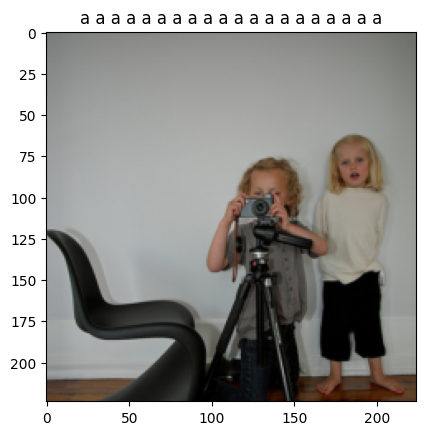

Epoch 1/40 [60/127] - Loss: 7.65530

Epoch 1/40 [70/127] - Loss: 7.59763

Epoch 1/40 [80/127] - Loss: 7.54554

Epoch 1/40 [90/127] - Loss: 7.54591

Epoch 1/40 [100/127] - Loss: 7.53291

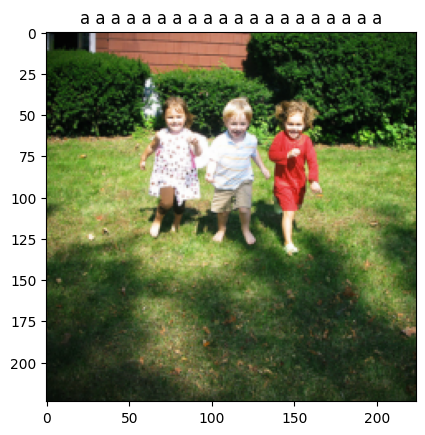

Epoch 1/40 [110/127] - Loss: 7.51512

Epoch 1/40 [120/127] - Loss: 7.50973

Starting epoch 2/40

Epoch 2/40 [1/127] - Loss: 7.51603

Epoch 2/40 [10/127] - Loss: 7.51764

Epoch 2/40 [20/127] - Loss: 7.47621

Epoch 2/40 [30/127] - Loss: 7.51151

Epoch 2/40 [40/127] - Loss: 7.47762

Epoch 2/40 [50/127] - Loss: 7.48091

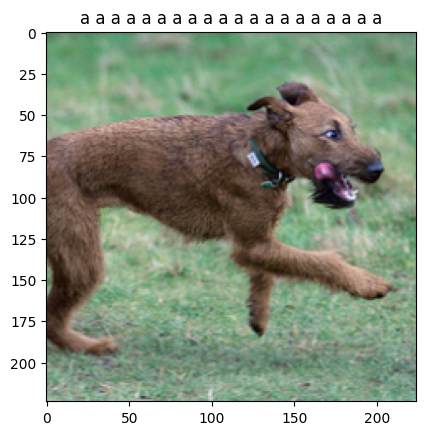

Epoch 2/40 [60/127] - Loss: 7.48409

Epoch 2/40 [70/127] - Loss: 7.47995

Epoch 2/40 [80/127] - Loss: 7.46754

Epoch 2/40 [90/127] - Loss: 7.49252

Epoch 2/40 [100/127] - Loss: 7.47298

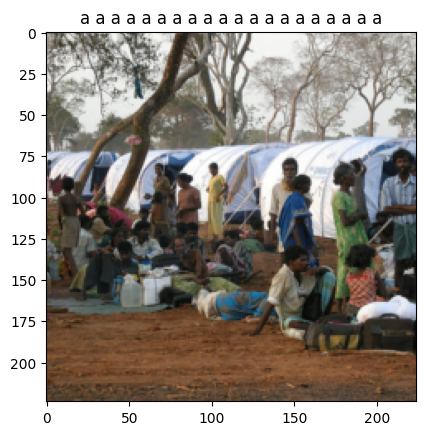

Epoch 2/40 [110/127] - Loss: 7.43459

Epoch 2/40 [120/127] - Loss: 7.45671

Starting epoch 3/40

Epoch 3/40 [1/127] - Loss: 7.47121

Epoch 3/40 [10/127] - Loss: 7.43946

Epoch 3/40 [20/127] - Loss: 7.45160

Epoch 3/40 [30/127] - Loss: 7.45645

Epoch 3/40 [40/127] - Loss: 7.47523

Epoch 3/40 [50/127] - Loss: 7.46842

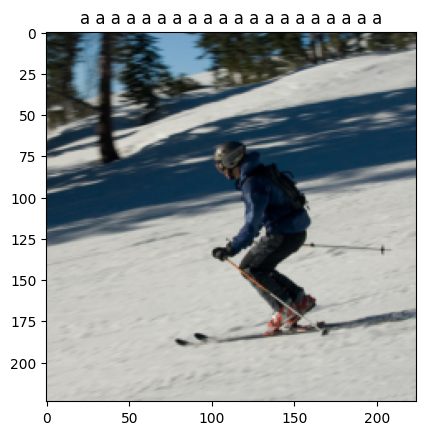

Epoch 3/40 [60/127] - Loss: 7.44782

Epoch 3/40 [70/127] - Loss: 7.45580

Epoch 3/40 [80/127] - Loss: 7.41948

Epoch 3/40 [90/127] - Loss: 7.42520

Epoch 3/40 [100/127] - Loss: 7.47112

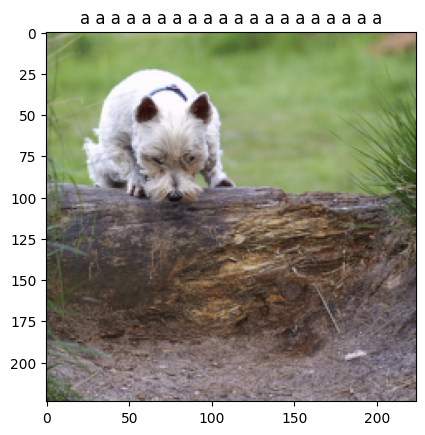

Epoch 3/40 [110/127] - Loss: 7.46702

Epoch 3/40 [120/127] - Loss: 7.44854

Starting epoch 4/40

Epoch 4/40 [1/127] - Loss: 7.47015

Epoch 4/40 [10/127] - Loss: 7.44025

Epoch 4/40 [20/127] - Loss: 7.46374

Epoch 4/40 [30/127] - Loss: 7.46196

Epoch 4/40 [40/127] - Loss: 7.46556

Epoch 4/40 [50/127] - Loss: 7.44735

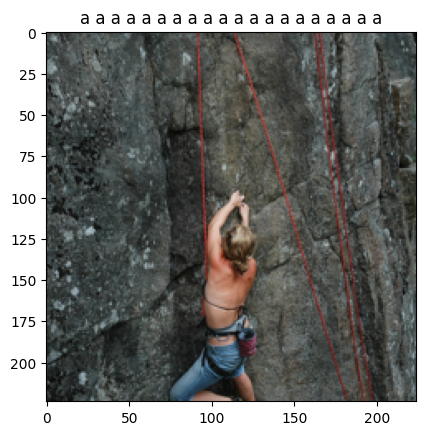

Epoch 4/40 [60/127] - Loss: 7.44630

Epoch 4/40 [70/127] - Loss: 7.44535

Epoch 4/40 [80/127] - Loss: 7.45492

Epoch 4/40 [90/127] - Loss: 7.44605

Epoch 4/40 [100/127] - Loss: 7.42729

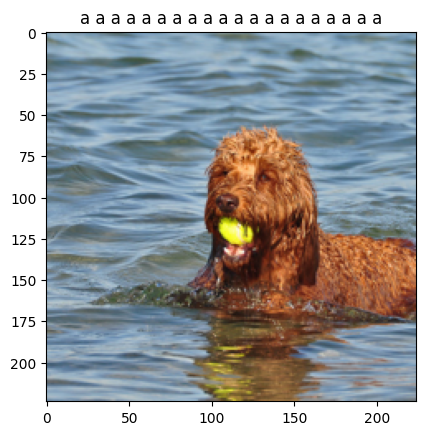

Epoch 4/40 [110/127] - Loss: 7.42370

Epoch 4/40 [120/127] - Loss: 7.42711

Starting epoch 5/40

Epoch 5/40 [1/127] - Loss: 7.43276

Epoch 5/40 [10/127] - Loss: 7.45332

Epoch 5/40 [20/127] - Loss: 7.43919

Epoch 5/40 [30/127] - Loss: 7.44068

Epoch 5/40 [40/127] - Loss: 7.42663

Epoch 5/40 [50/127] - Loss: 7.41803

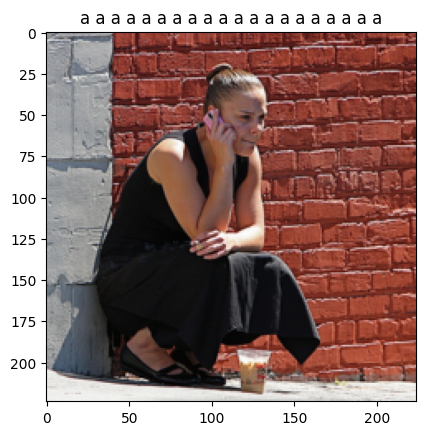

Epoch 5/40 [60/127] - Loss: 7.43315

Epoch 5/40 [70/127] - Loss: 7.42904

Epoch 5/40 [80/127] - Loss: 7.43678

Epoch 5/40 [90/127] - Loss: 7.43194

Epoch 5/40 [100/127] - Loss: 7.42982

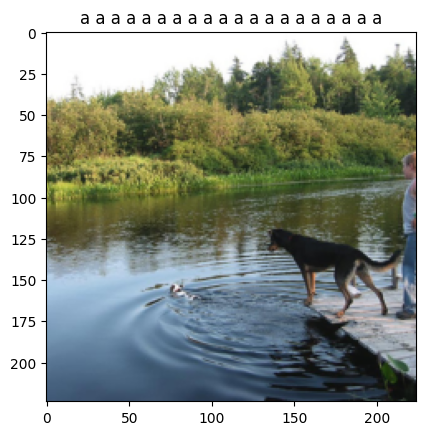

Epoch 5/40 [110/127] - Loss: 7.42722

Epoch 5/40 [120/127] - Loss: 7.44182

Starting epoch 6/40

Epoch 6/40 [1/127] - Loss: 7.41610

Epoch 6/40 [10/127] - Loss: 7.43393

Epoch 6/40 [20/127] - Loss: 7.40358

Epoch 6/40 [30/127] - Loss: 7.45472

Epoch 6/40 [40/127] - Loss: 7.42042

Epoch 6/40 [50/127] - Loss: 7.44043

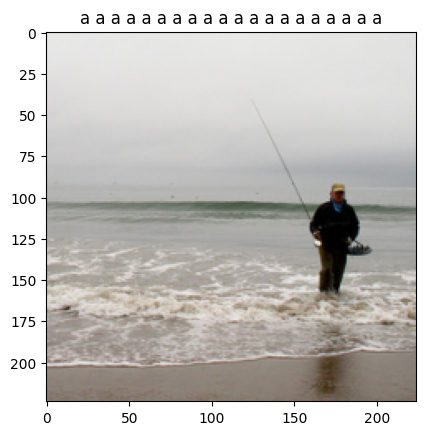

Epoch 6/40 [60/127] - Loss: 7.43113

Epoch 6/40 [70/127] - Loss: 7.43344

Epoch 6/40 [80/127] - Loss: 7.42485

Epoch 6/40 [90/127] - Loss: 7.44027

Epoch 6/40 [100/127] - Loss: 7.42224

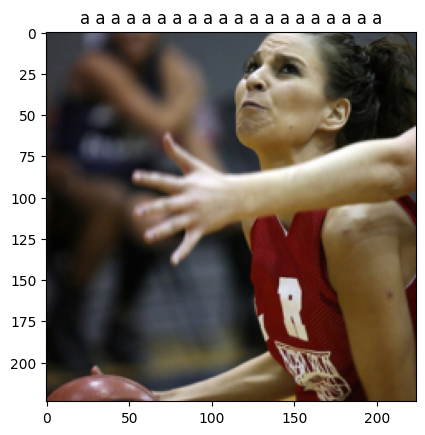

Epoch 6/40 [110/127] - Loss: 7.43568

Epoch 6/40 [120/127] - Loss: 7.43452

Starting epoch 7/40

Epoch 7/40 [1/127] - Loss: 7.42828

Epoch 7/40 [10/127] - Loss: 7.42329

Epoch 7/40 [20/127] - Loss: 7.43482

Epoch 7/40 [30/127] - Loss: 7.43230

Epoch 7/40 [40/127] - Loss: 7.42346

Epoch 7/40 [50/127] - Loss: 7.44496

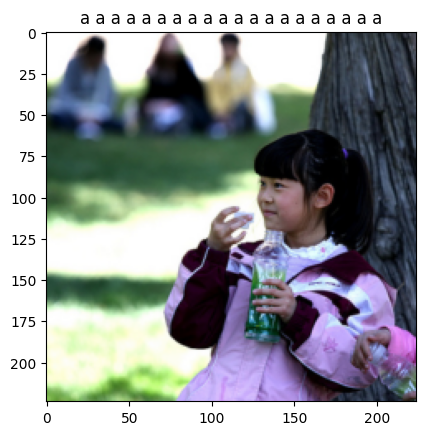

Epoch 7/40 [60/127] - Loss: 7.40787

Epoch 7/40 [70/127] - Loss: 7.45250

Epoch 7/40 [80/127] - Loss: 7.41947

Epoch 7/40 [90/127] - Loss: 7.41953

Epoch 7/40 [100/127] - Loss: 7.43538

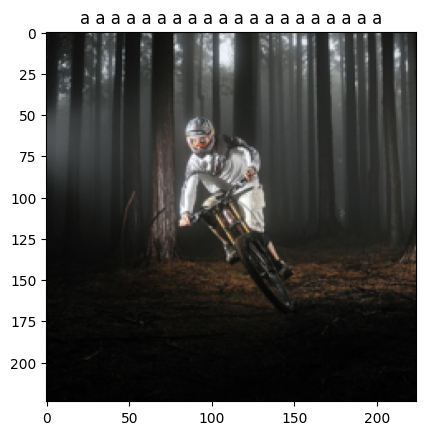

Epoch 7/40 [110/127] - Loss: 7.43984

Epoch 7/40 [120/127] - Loss: 7.43940

Starting epoch 8/40

Epoch 8/40 [1/127] - Loss: 7.43161

Epoch 8/40 [10/127] - Loss: 7.41847

Epoch 8/40 [20/127] - Loss: 7.42297

Epoch 8/40 [30/127] - Loss: 7.40250

Epoch 8/40 [40/127] - Loss: 7.41860

Epoch 8/40 [50/127] - Loss: 7.39816

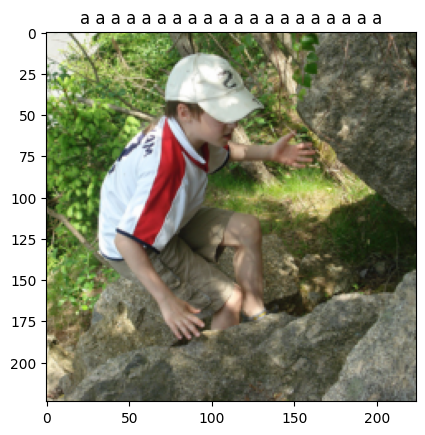

Epoch 8/40 [60/127] - Loss: 7.39661

Epoch 8/40 [70/127] - Loss: 7.43314

Epoch 8/40 [80/127] - Loss: 7.43615

Epoch 8/40 [90/127] - Loss: 7.42815

Epoch 8/40 [100/127] - Loss: 7.43423

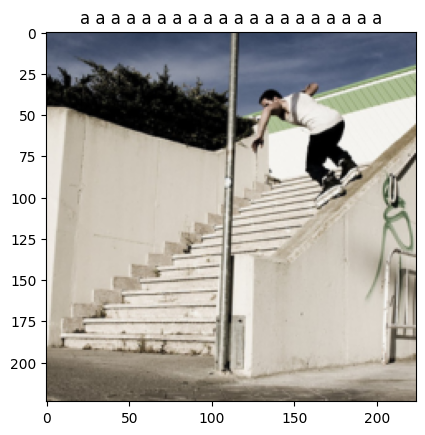

Epoch 8/40 [110/127] - Loss: 7.43772

Epoch 8/40 [120/127] - Loss: 7.44832

Starting epoch 9/40

Epoch 9/40 [1/127] - Loss: 7.44491

Epoch 9/40 [10/127] - Loss: 7.40261

Epoch 9/40 [20/127] - Loss: 7.41644

Epoch 9/40 [30/127] - Loss: 7.43203

Epoch 9/40 [40/127] - Loss: 7.44506

Epoch 9/40 [50/127] - Loss: 7.44120

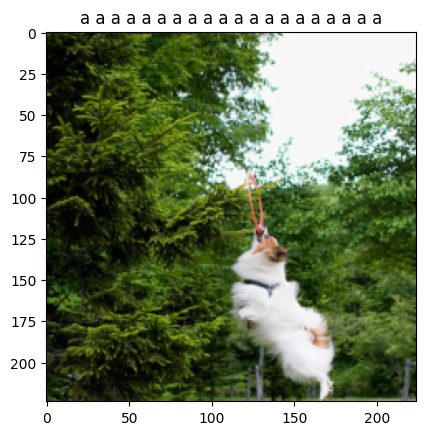

Epoch 9/40 [60/127] - Loss: 7.39628

Epoch 9/40 [70/127] - Loss: 7.43761

Epoch 9/40 [80/127] - Loss: 7.42243

Epoch 9/40 [90/127] - Loss: 7.43626

Epoch 9/40 [100/127] - Loss: 7.42030

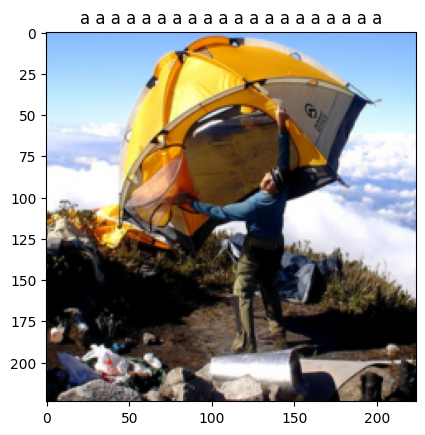

Epoch 9/40 [110/127] - Loss: 7.42387

Epoch 9/40 [120/127] - Loss: 7.42942

Starting epoch 10/40

Epoch 10/40 [1/127] - Loss: 7.42659

Epoch 10/40 [10/127] - Loss: 7.42152

Epoch 10/40 [20/127] - Loss: 7.41221

Epoch 10/40 [30/127] - Loss: 7.42415

Epoch 10/40 [40/127] - Loss: 7.41920

Epoch 10/40 [50/127] - Loss: 7.44430

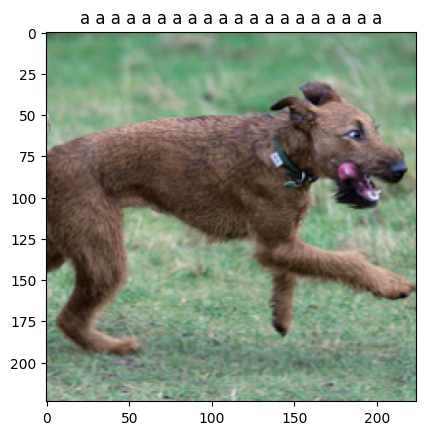

Epoch 10/40 [60/127] - Loss: 7.42058

Epoch 10/40 [70/127] - Loss: 7.39911

Epoch 10/40 [80/127] - Loss: 7.44119

Epoch 10/40 [90/127] - Loss: 7.40697

Epoch 10/40 [100/127] - Loss: 7.43076

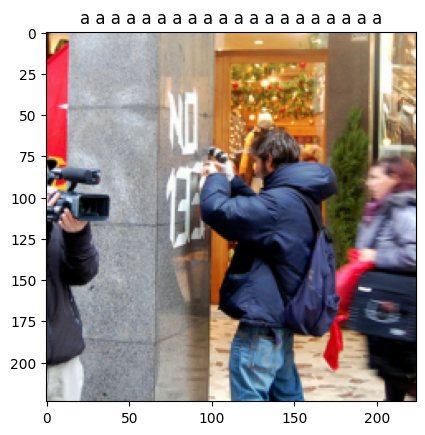

Epoch 10/40 [110/127] - Loss: 7.40465

Epoch 10/40 [120/127] - Loss: 7.41193

Starting epoch 11/40

Epoch 11/40 [1/127] - Loss: 7.42605

Epoch 11/40 [10/127] - Loss: 7.42692

Epoch 11/40 [20/127] - Loss: 7.41569

Epoch 11/40 [30/127] - Loss: 7.41916

Epoch 11/40 [40/127] - Loss: 7.41133

Epoch 11/40 [50/127] - Loss: 7.43044

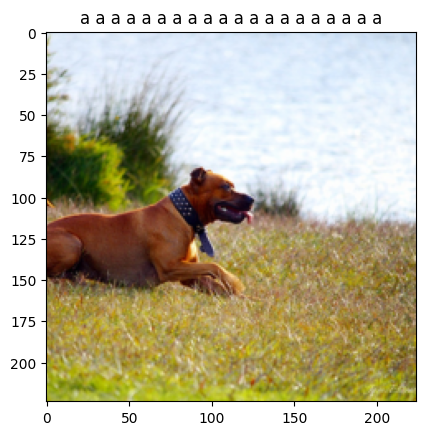

Epoch 11/40 [60/127] - Loss: 7.43499

Epoch 11/40 [70/127] - Loss: 7.42638

Epoch 11/40 [80/127] - Loss: 7.42342

Epoch 11/40 [90/127] - Loss: 7.41364

Epoch 11/40 [100/127] - Loss: 7.42981

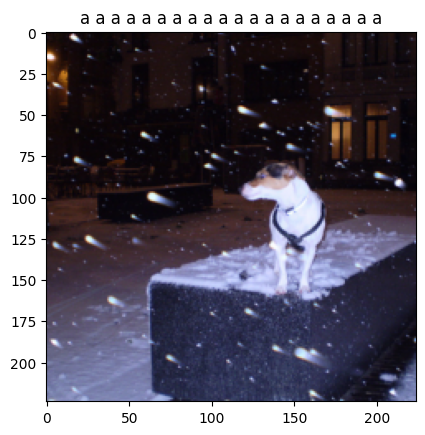

Epoch 11/40 [110/127] - Loss: 7.42917

Epoch 11/40 [120/127] - Loss: 7.40487

Starting epoch 12/40

Epoch 12/40 [1/127] - Loss: 7.42679

Epoch 12/40 [10/127] - Loss: 7.40205

Epoch 12/40 [20/127] - Loss: 7.41246

Epoch 12/40 [30/127] - Loss: 7.42114

Epoch 12/40 [40/127] - Loss: 7.40642

Epoch 12/40 [50/127] - Loss: 7.41023

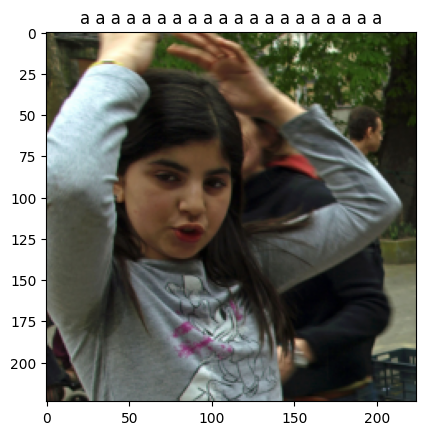

Epoch 12/40 [60/127] - Loss: 7.44686

Epoch 12/40 [70/127] - Loss: 7.40974

Epoch 12/40 [80/127] - Loss: 7.43243

Epoch 12/40 [90/127] - Loss: 7.42120

Epoch 12/40 [100/127] - Loss: 7.43578

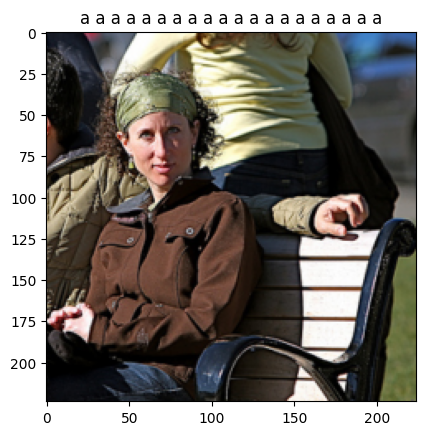

Epoch 12/40 [110/127] - Loss: 7.45134

Epoch 12/40 [120/127] - Loss: 7.42024

Starting epoch 13/40

Epoch 13/40 [1/127] - Loss: 7.41391

Epoch 13/40 [10/127] - Loss: 7.40925

Epoch 13/40 [20/127] - Loss: 7.41864

Epoch 13/40 [30/127] - Loss: 7.41267

Epoch 13/40 [40/127] - Loss: 7.39263

Epoch 13/40 [50/127] - Loss: 7.41191

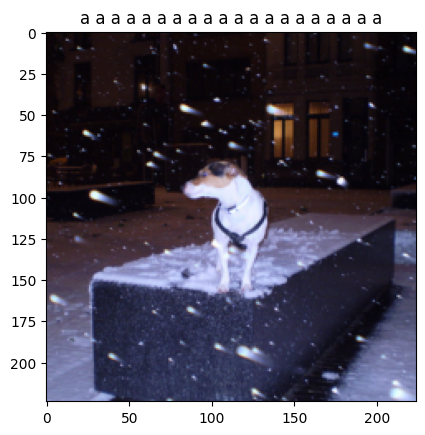

Epoch 13/40 [60/127] - Loss: 7.44971

Epoch 13/40 [70/127] - Loss: 7.42773

Epoch 13/40 [80/127] - Loss: 7.41789

Epoch 13/40 [90/127] - Loss: 7.41212

Epoch 13/40 [100/127] - Loss: 7.41114

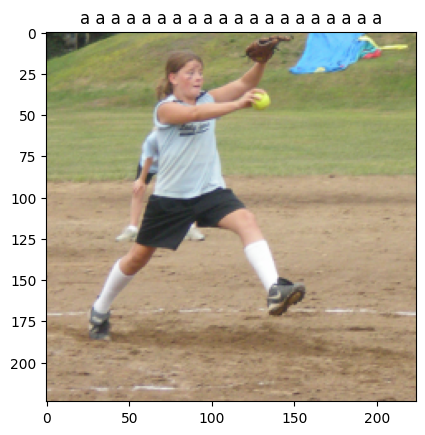

Epoch 13/40 [110/127] - Loss: 7.40515

Epoch 13/40 [120/127] - Loss: 7.41072

Starting epoch 14/40

Epoch 14/40 [1/127] - Loss: 7.42084

Epoch 14/40 [10/127] - Loss: 7.42091

Epoch 14/40 [20/127] - Loss: 7.42039

Epoch 14/40 [30/127] - Loss: 7.41410

Epoch 14/40 [40/127] - Loss: 7.42738

Epoch 14/40 [50/127] - Loss: 7.39931

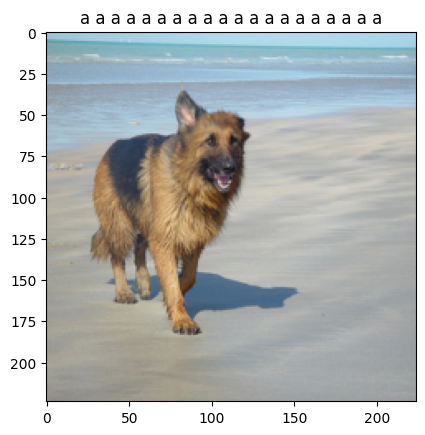

Epoch 14/40 [60/127] - Loss: 7.41764

Epoch 14/40 [70/127] - Loss: 7.41666

Epoch 14/40 [80/127] - Loss: 7.42168

Epoch 14/40 [90/127] - Loss: 7.43096

Epoch 14/40 [100/127] - Loss: 7.41930

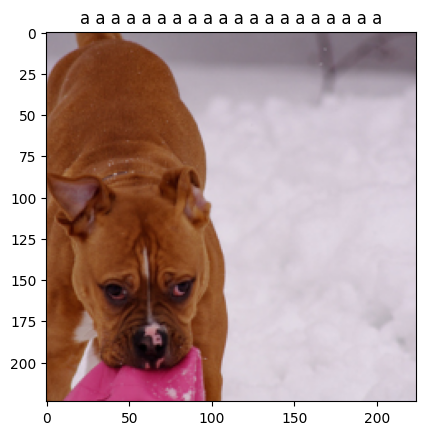

Epoch 14/40 [110/127] - Loss: 7.42948

Epoch 14/40 [120/127] - Loss: 7.41462

Starting epoch 15/40

Epoch 15/40 [1/127] - Loss: 7.40564

Epoch 15/40 [10/127] - Loss: 7.41006

Epoch 15/40 [20/127] - Loss: 7.42772

Epoch 15/40 [30/127] - Loss: 7.42321

Epoch 15/40 [40/127] - Loss: 7.41352

Epoch 15/40 [50/127] - Loss: 7.40708

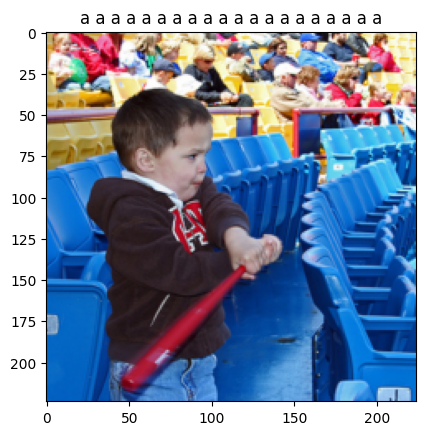

Epoch 15/40 [60/127] - Loss: 7.41519

Epoch 15/40 [70/127] - Loss: 7.42047

Epoch 15/40 [80/127] - Loss: 7.43612

Epoch 15/40 [90/127] - Loss: 7.41848

Epoch 15/40 [100/127] - Loss: 7.43009

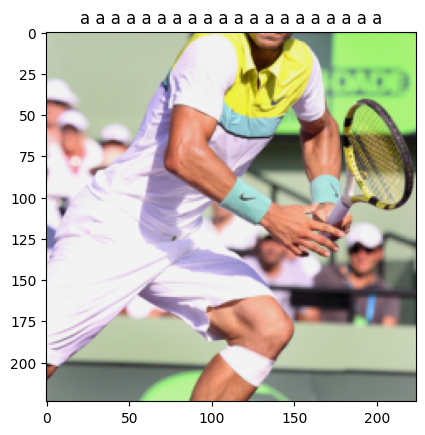

Epoch 15/40 [110/127] - Loss: 7.41151

Epoch 15/40 [120/127] - Loss: 7.43606

Starting epoch 16/40

Epoch 16/40 [1/127] - Loss: 7.41010

Epoch 16/40 [10/127] - Loss: 7.40150

Epoch 16/40 [20/127] - Loss: 7.41782

Epoch 16/40 [30/127] - Loss: 7.42864

Epoch 16/40 [40/127] - Loss: 7.42228

Epoch 16/40 [50/127] - Loss: 7.41187

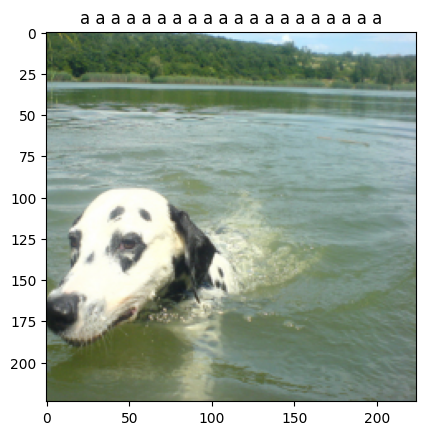

Epoch 16/40 [60/127] - Loss: 7.43297

Epoch 16/40 [70/127] - Loss: 7.40780

Epoch 16/40 [80/127] - Loss: 7.41053

Epoch 16/40 [90/127] - Loss: 7.43169

Epoch 16/40 [100/127] - Loss: 7.41693

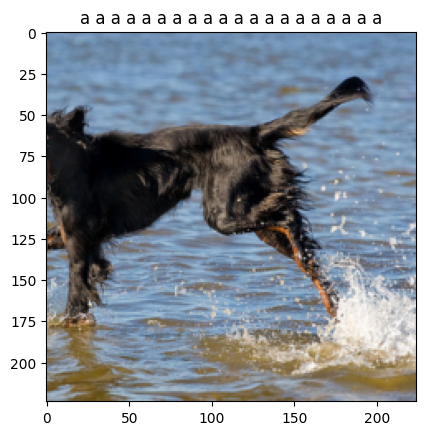

Epoch 16/40 [110/127] - Loss: 7.42300

Epoch 16/40 [120/127] - Loss: 7.41206

Starting epoch 17/40

Epoch 17/40 [1/127] - Loss: 7.40225

Epoch 17/40 [10/127] - Loss: 7.42961

Epoch 17/40 [20/127] - Loss: 7.41957

Epoch 17/40 [30/127] - Loss: 7.39725

Epoch 17/40 [40/127] - Loss: 7.42044

Epoch 17/40 [50/127] - Loss: 7.41040

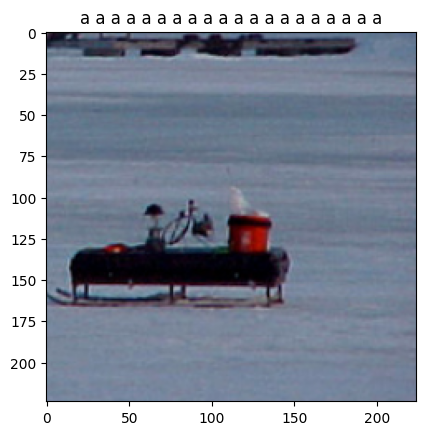

Epoch 17/40 [60/127] - Loss: 7.43757

Epoch 17/40 [70/127] - Loss: 7.43981

Epoch 17/40 [80/127] - Loss: 7.41884

Epoch 17/40 [90/127] - Loss: 7.42975

Epoch 17/40 [100/127] - Loss: 7.41892

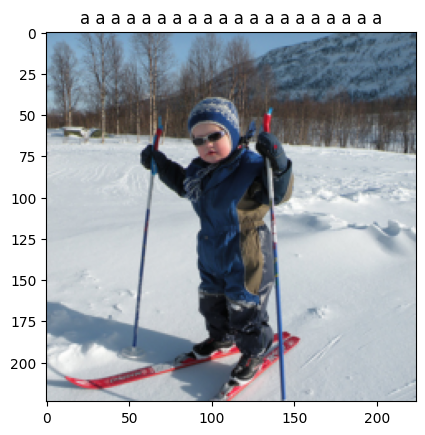

Epoch 17/40 [110/127] - Loss: 7.39954

Epoch 17/40 [120/127] - Loss: 7.40836

Starting epoch 18/40

Epoch 18/40 [1/127] - Loss: 7.41125

Epoch 18/40 [10/127] - Loss: 7.41221

Epoch 18/40 [20/127] - Loss: 7.40499

Epoch 18/40 [30/127] - Loss: 7.40951

Epoch 18/40 [40/127] - Loss: 7.40969

Epoch 18/40 [50/127] - Loss: 7.41224

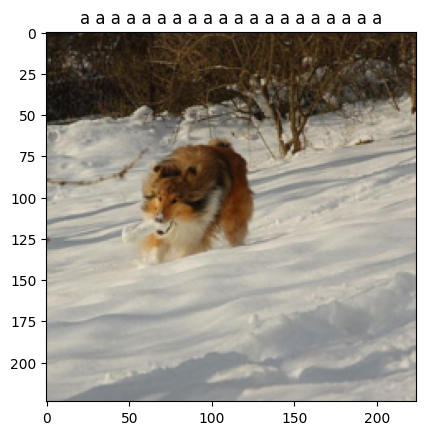

Epoch 18/40 [60/127] - Loss: 7.41837

Epoch 18/40 [70/127] - Loss: 7.44903

Epoch 18/40 [80/127] - Loss: 7.40935

Epoch 18/40 [90/127] - Loss: 7.40430

Epoch 18/40 [100/127] - Loss: 7.42053

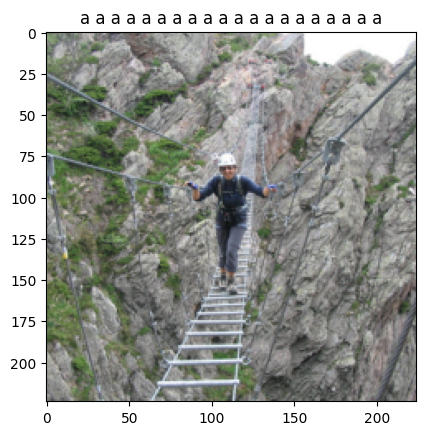

Epoch 18/40 [110/127] - Loss: 7.40430

Epoch 18/40 [120/127] - Loss: 7.42836

Starting epoch 19/40

Epoch 19/40 [1/127] - Loss: 7.43587

Epoch 19/40 [10/127] - Loss: 7.40859

Epoch 19/40 [20/127] - Loss: 7.40517

Epoch 19/40 [30/127] - Loss: 7.41404

Epoch 19/40 [40/127] - Loss: 7.42649

Epoch 19/40 [50/127] - Loss: 7.41032

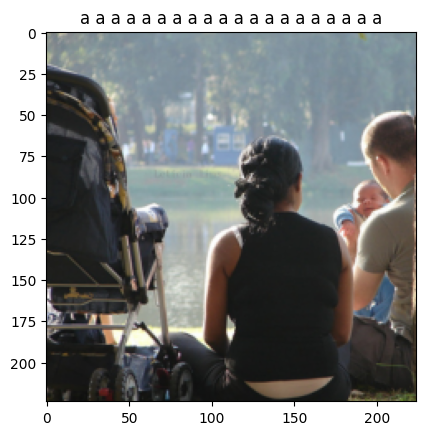

Epoch 19/40 [60/127] - Loss: 7.41929

Epoch 19/40 [70/127] - Loss: 7.42035

Epoch 19/40 [80/127] - Loss: 7.45001

Epoch 19/40 [90/127] - Loss: 7.42103

Epoch 19/40 [100/127] - Loss: 7.42191

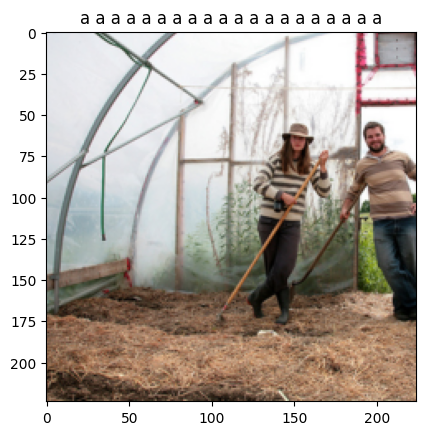

Epoch 19/40 [110/127] - Loss: 7.42708

Epoch 19/40 [120/127] - Loss: 7.41113

Starting epoch 20/40

Epoch 20/40 [1/127] - Loss: 7.40068

Epoch 20/40 [10/127] - Loss: 7.41957

Epoch 20/40 [20/127] - Loss: 7.41410

Epoch 20/40 [30/127] - Loss: 7.41745

Epoch 20/40 [40/127] - Loss: 7.41747

Epoch 20/40 [50/127] - Loss: 7.39431

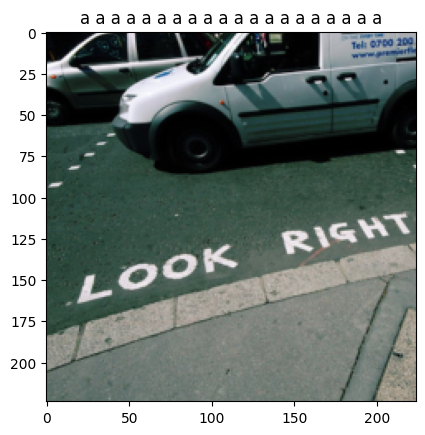

Epoch 20/40 [60/127] - Loss: 7.40834

Epoch 20/40 [70/127] - Loss: 7.42023

Epoch 20/40 [80/127] - Loss: 7.40991

Epoch 20/40 [90/127] - Loss: 7.41868

Epoch 20/40 [100/127] - Loss: 7.40183

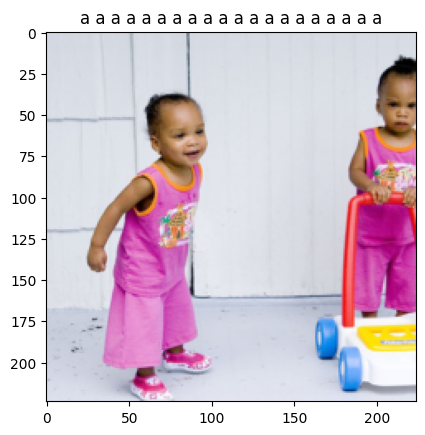

Epoch 20/40 [110/127] - Loss: 7.44303

Epoch 20/40 [120/127] - Loss: 7.40420

Starting epoch 21/40

Epoch 21/40 [1/127] - Loss: 7.41879

Epoch 21/40 [10/127] - Loss: 7.39726

Epoch 21/40 [20/127] - Loss: 7.40924

Epoch 21/40 [30/127] - Loss: 7.43697

Epoch 21/40 [40/127] - Loss: 7.41738

Epoch 21/40 [50/127] - Loss: 7.43695

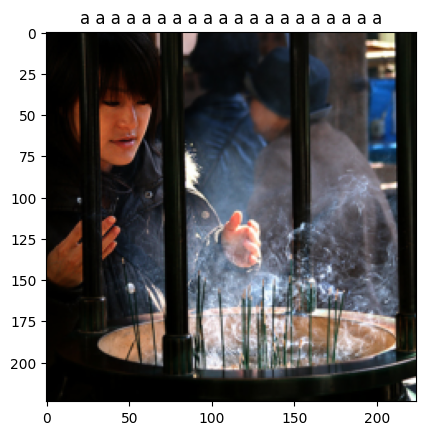

Epoch 21/40 [60/127] - Loss: 7.41046

Epoch 21/40 [70/127] - Loss: 7.40896

Epoch 21/40 [80/127] - Loss: 7.43690

Epoch 21/40 [90/127] - Loss: 7.40758

Epoch 21/40 [100/127] - Loss: 7.41293

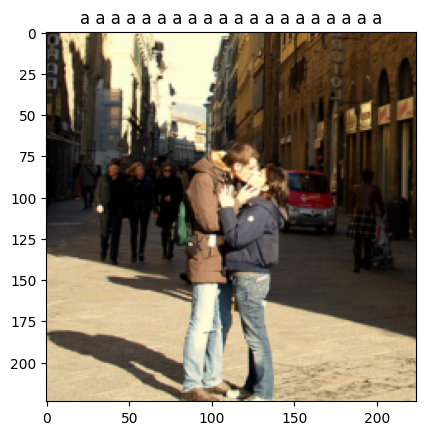

Epoch 21/40 [110/127] - Loss: 7.40874

Epoch 21/40 [120/127] - Loss: 7.41903

Starting epoch 22/40

Epoch 22/40 [1/127] - Loss: 7.41335

Epoch 22/40 [10/127] - Loss: 7.42295

Epoch 22/40 [20/127] - Loss: 7.41327

Epoch 22/40 [30/127] - Loss: 7.42632

Epoch 22/40 [40/127] - Loss: 7.41522

Epoch 22/40 [50/127] - Loss: 7.41600

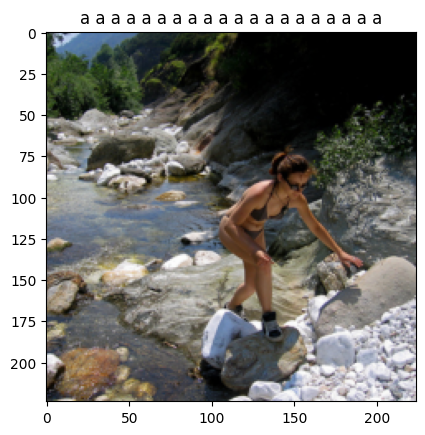

Epoch 22/40 [60/127] - Loss: 7.39792

Epoch 22/40 [70/127] - Loss: 7.41753

Epoch 22/40 [80/127] - Loss: 7.42850

Epoch 22/40 [90/127] - Loss: 7.42349

Epoch 22/40 [100/127] - Loss: 7.38891

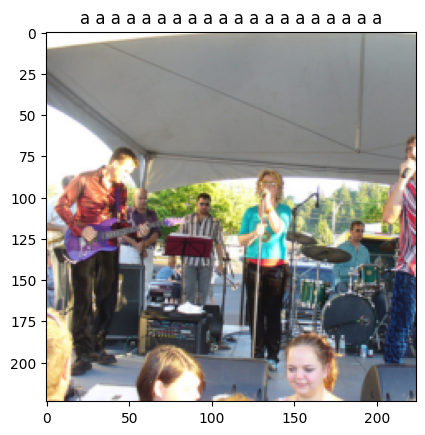

Epoch 22/40 [110/127] - Loss: 7.40660

Epoch 22/40 [120/127] - Loss: 7.40982

Starting epoch 23/40

Epoch 23/40 [1/127] - Loss: 7.41245

Epoch 23/40 [10/127] - Loss: 7.41164

Epoch 23/40 [20/127] - Loss: 7.40779

Epoch 23/40 [30/127] - Loss: 7.42705

Epoch 23/40 [40/127] - Loss: 7.41395

Epoch 23/40 [50/127] - Loss: 7.42042

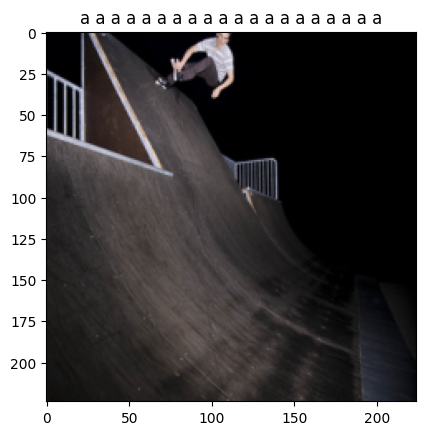

Epoch 23/40 [60/127] - Loss: 7.44565

Epoch 23/40 [70/127] - Loss: 7.40399

Epoch 23/40 [80/127] - Loss: 7.40822

Epoch 23/40 [90/127] - Loss: 7.39190

Epoch 23/40 [100/127] - Loss: 7.37757

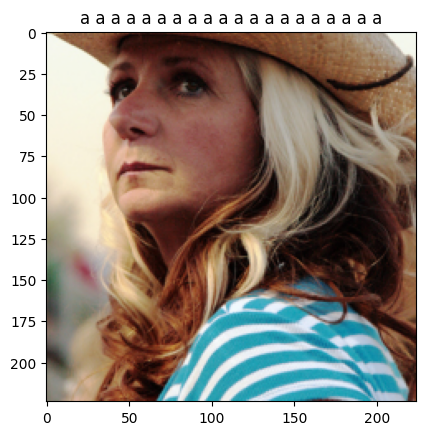

Epoch 23/40 [110/127] - Loss: 7.41186

Epoch 23/40 [120/127] - Loss: 7.42116

Starting epoch 24/40

Epoch 24/40 [1/127] - Loss: 7.39258

Epoch 24/40 [10/127] - Loss: 7.40547

Epoch 24/40 [20/127] - Loss: 7.39630

Epoch 24/40 [30/127] - Loss: 7.40985

Epoch 24/40 [40/127] - Loss: 7.41673

Epoch 24/40 [50/127] - Loss: 7.40836

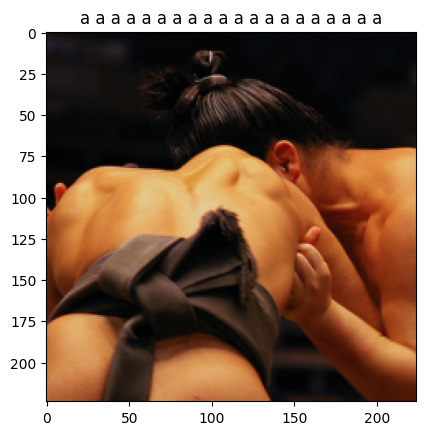

Epoch 24/40 [60/127] - Loss: 7.42543

Epoch 24/40 [70/127] - Loss: 7.43526

Epoch 24/40 [80/127] - Loss: 7.40192

Epoch 24/40 [90/127] - Loss: 7.41362

Epoch 24/40 [100/127] - Loss: 7.41409

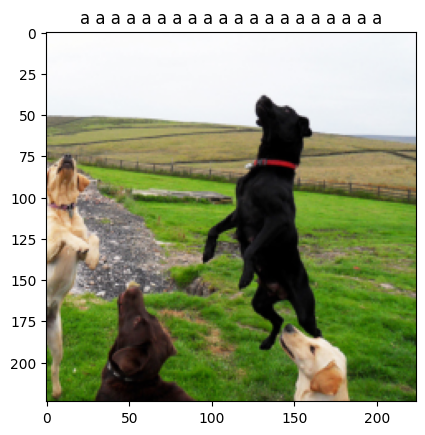

Epoch 24/40 [110/127] - Loss: 7.39600

Epoch 24/40 [120/127] - Loss: 7.40453

Starting epoch 25/40

Epoch 25/40 [1/127] - Loss: 7.42295

Epoch 25/40 [10/127] - Loss: 7.43967

Epoch 25/40 [20/127] - Loss: 7.40349

Epoch 25/40 [30/127] - Loss: 7.41775

Epoch 25/40 [40/127] - Loss: 7.42317

Epoch 25/40 [50/127] - Loss: 7.39561

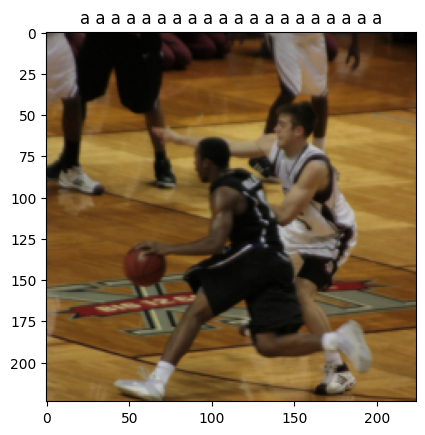

Epoch 25/40 [60/127] - Loss: 7.40690

Epoch 25/40 [70/127] - Loss: 7.40404

Epoch 25/40 [80/127] - Loss: 7.39538

Epoch 25/40 [90/127] - Loss: 7.41191

Epoch 25/40 [100/127] - Loss: 7.42792

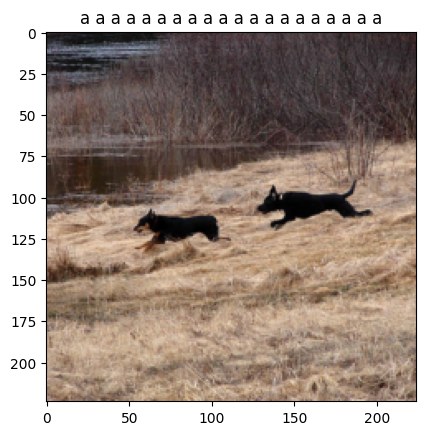

Epoch 25/40 [110/127] - Loss: 7.40989

Epoch 25/40 [120/127] - Loss: 7.41333

Starting epoch 26/40

Epoch 26/40 [1/127] - Loss: 7.41372

Epoch 26/40 [10/127] - Loss: 7.41947

Epoch 26/40 [20/127] - Loss: 7.40685

Epoch 26/40 [30/127] - Loss: 7.41062

Epoch 26/40 [40/127] - Loss: 7.42587

Epoch 26/40 [50/127] - Loss: 7.42450

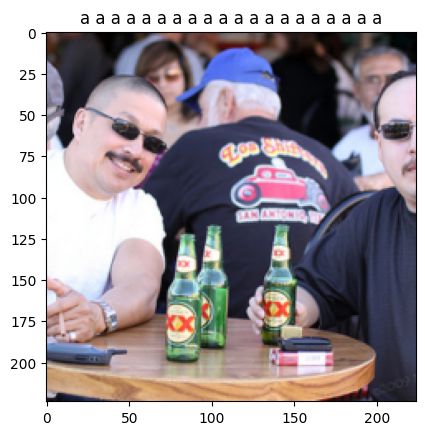

Epoch 26/40 [60/127] - Loss: 7.41643

Epoch 26/40 [70/127] - Loss: 7.42697

Epoch 26/40 [80/127] - Loss: 7.41939

Epoch 26/40 [90/127] - Loss: 7.40167

Epoch 26/40 [100/127] - Loss: 7.42649

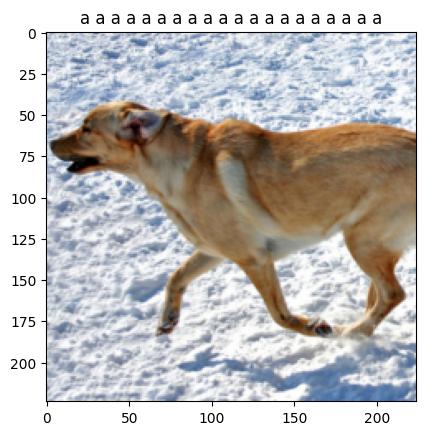

Epoch 26/40 [110/127] - Loss: 7.41644

Epoch 26/40 [120/127] - Loss: 7.42655

Starting epoch 27/40

Epoch 27/40 [1/127] - Loss: 7.41513

Epoch 27/40 [10/127] - Loss: 7.39714

Epoch 27/40 [20/127] - Loss: 7.41052

Epoch 27/40 [30/127] - Loss: 7.41032

Epoch 27/40 [40/127] - Loss: 7.42718

Epoch 27/40 [50/127] - Loss: 7.42807

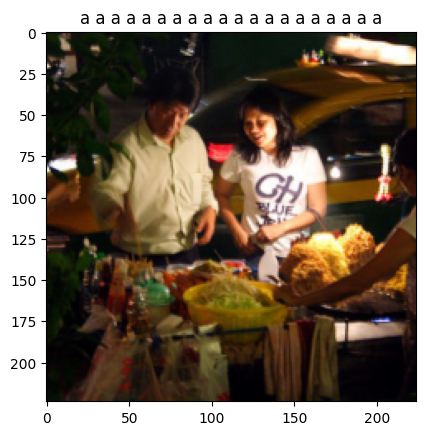

Epoch 27/40 [60/127] - Loss: 7.39575

Epoch 27/40 [70/127] - Loss: 7.41016

Epoch 27/40 [80/127] - Loss: 7.43100

Epoch 27/40 [90/127] - Loss: 7.42188

Epoch 27/40 [100/127] - Loss: 7.43226

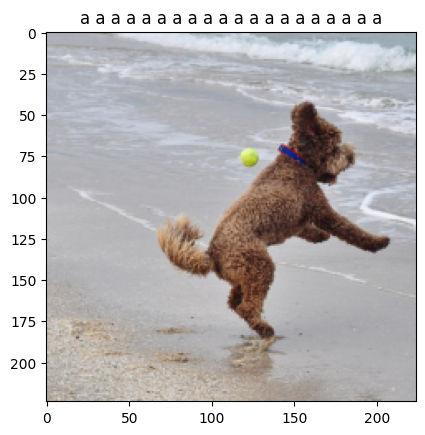

Epoch 27/40 [110/127] - Loss: 7.40826

Epoch 27/40 [120/127] - Loss: 7.41125

Starting epoch 28/40

Epoch 28/40 [1/127] - Loss: 7.39536

Epoch 28/40 [10/127] - Loss: 7.40254

Epoch 28/40 [20/127] - Loss: 7.41155

Epoch 28/40 [30/127] - Loss: 7.41143

Epoch 28/40 [40/127] - Loss: 7.41815

Epoch 28/40 [50/127] - Loss: 7.40371

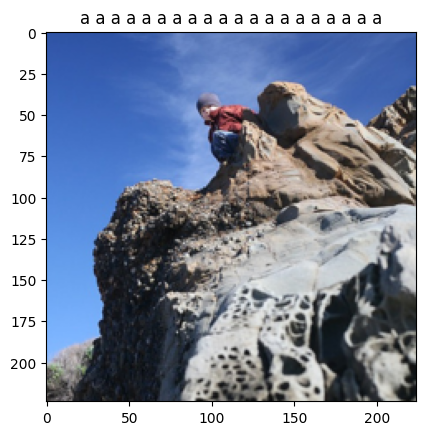

Epoch 28/40 [60/127] - Loss: 7.40552

Epoch 28/40 [70/127] - Loss: 7.40930

Epoch 28/40 [80/127] - Loss: 7.39401

Epoch 28/40 [90/127] - Loss: 7.43054

Epoch 28/40 [100/127] - Loss: 7.41997

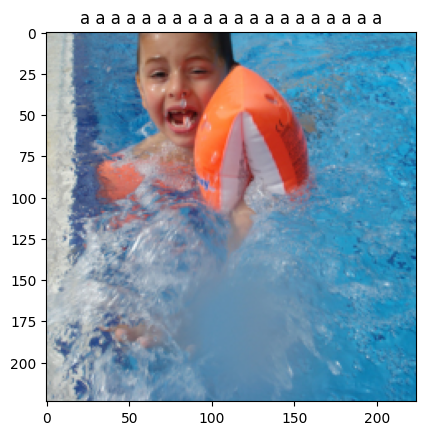

Epoch 28/40 [110/127] - Loss: 7.41545

Epoch 28/40 [120/127] - Loss: 7.39807

Starting epoch 29/40

Epoch 29/40 [1/127] - Loss: 7.41363

Epoch 29/40 [10/127] - Loss: 7.44686

Epoch 29/40 [20/127] - Loss: 7.40174

Epoch 29/40 [30/127] - Loss: 7.40623

Epoch 29/40 [40/127] - Loss: 7.40145

Epoch 29/40 [50/127] - Loss: 7.42345

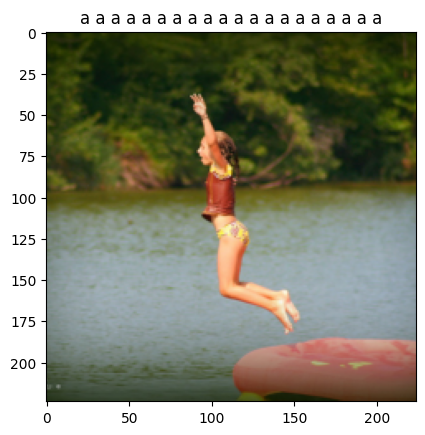

Epoch 29/40 [60/127] - Loss: 7.42911

Epoch 29/40 [70/127] - Loss: 7.40859

Epoch 29/40 [80/127] - Loss: 7.41414

Epoch 29/40 [90/127] - Loss: 7.43476

Epoch 29/40 [100/127] - Loss: 7.41129

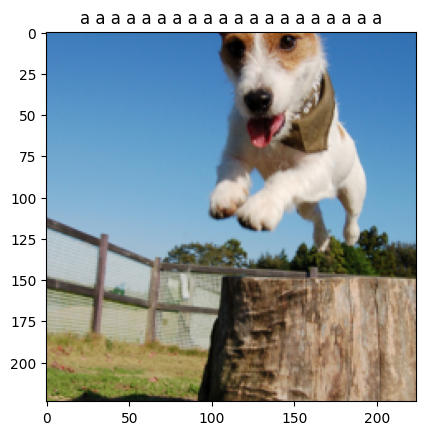

Epoch 29/40 [110/127] - Loss: 7.40371

Epoch 29/40 [120/127] - Loss: 7.41138

Starting epoch 30/40

Epoch 30/40 [1/127] - Loss: 7.41496

Epoch 30/40 [10/127] - Loss: 7.41290

Epoch 30/40 [20/127] - Loss: 7.43442

Epoch 30/40 [30/127] - Loss: 7.40312

Epoch 30/40 [40/127] - Loss: 7.42989

Epoch 30/40 [50/127] - Loss: 7.41716

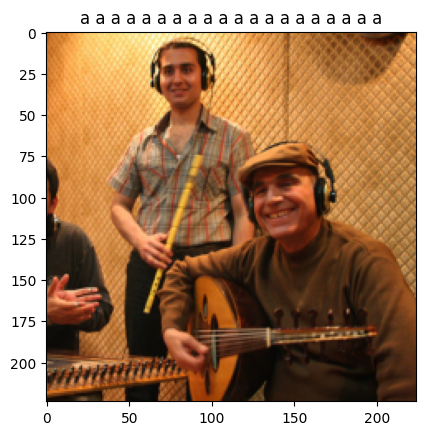

Epoch 30/40 [60/127] - Loss: 7.41419

Epoch 30/40 [70/127] - Loss: 7.41195

Epoch 30/40 [80/127] - Loss: 7.42385

Epoch 30/40 [90/127] - Loss: 7.39690

Epoch 30/40 [100/127] - Loss: 7.39930

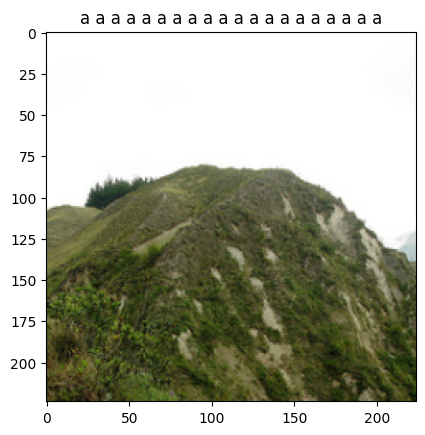

Epoch 30/40 [110/127] - Loss: 7.43103

Epoch 30/40 [120/127] - Loss: 7.41289

Starting epoch 31/40

Epoch 31/40 [1/127] - Loss: 7.41350

Epoch 31/40 [10/127] - Loss: 7.41393

Epoch 31/40 [20/127] - Loss: 7.41523

Epoch 31/40 [30/127] - Loss: 7.41361

Epoch 31/40 [40/127] - Loss: 7.40771

Epoch 31/40 [50/127] - Loss: 7.41987

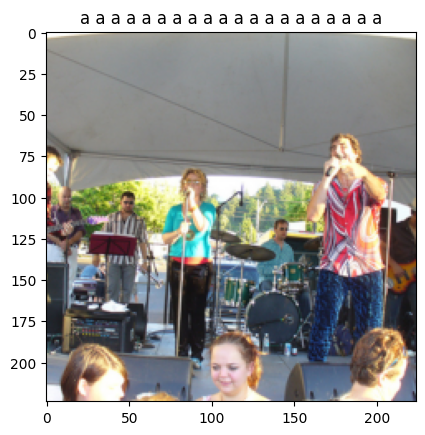

Epoch 31/40 [60/127] - Loss: 7.38876

Epoch 31/40 [70/127] - Loss: 7.41060

Epoch 31/40 [80/127] - Loss: 7.38275

Epoch 31/40 [90/127] - Loss: 7.40993

Epoch 31/40 [100/127] - Loss: 7.42012

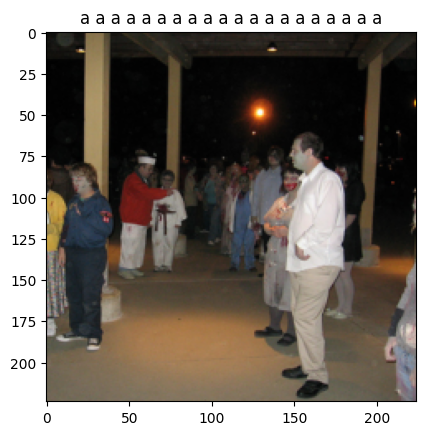

Epoch 31/40 [110/127] - Loss: 7.42647

Epoch 31/40 [120/127] - Loss: 7.43939

Starting epoch 32/40

Epoch 32/40 [1/127] - Loss: 7.40842

Epoch 32/40 [10/127] - Loss: 7.42140

Epoch 32/40 [20/127] - Loss: 7.41918

Epoch 32/40 [30/127] - Loss: 7.42046

Epoch 32/40 [40/127] - Loss: 7.42083

Epoch 32/40 [50/127] - Loss: 7.42436

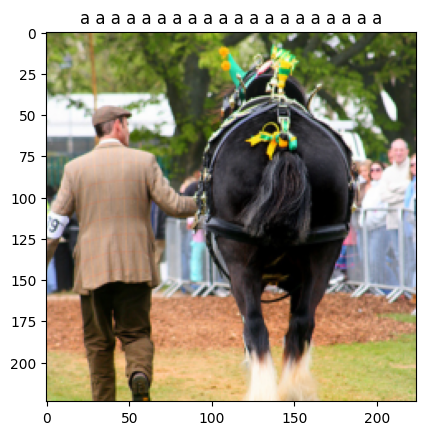

Epoch 32/40 [60/127] - Loss: 7.40871

Epoch 32/40 [70/127] - Loss: 7.40040

Epoch 32/40 [80/127] - Loss: 7.39096

Epoch 32/40 [90/127] - Loss: 7.42401

Epoch 32/40 [100/127] - Loss: 7.39795

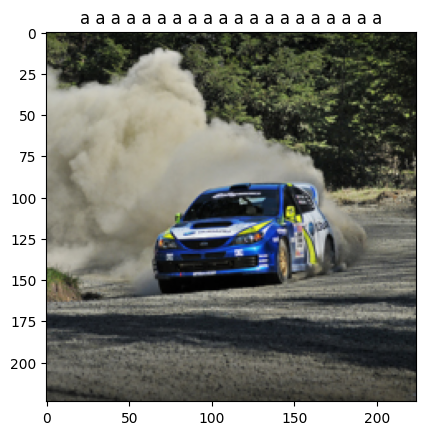

Epoch 32/40 [110/127] - Loss: 7.40477

Epoch 32/40 [120/127] - Loss: 7.41913

Starting epoch 33/40

Epoch 33/40 [1/127] - Loss: 7.42150

Epoch 33/40 [10/127] - Loss: 7.42325

Epoch 33/40 [20/127] - Loss: 7.39593

Epoch 33/40 [30/127] - Loss: 7.39035

Epoch 33/40 [40/127] - Loss: 7.41877

Epoch 33/40 [50/127] - Loss: 7.42588

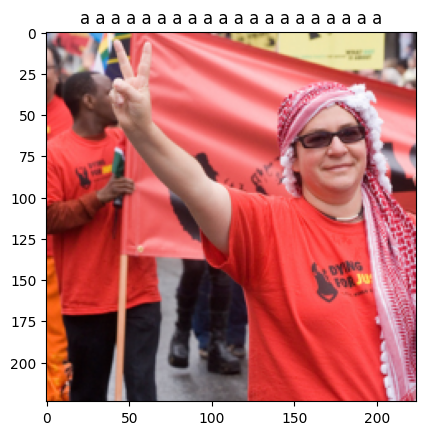

Epoch 33/40 [60/127] - Loss: 7.41756

Epoch 33/40 [70/127] - Loss: 7.42025

Epoch 33/40 [80/127] - Loss: 7.42011

Epoch 33/40 [90/127] - Loss: 7.41306

Epoch 33/40 [100/127] - Loss: 7.39361

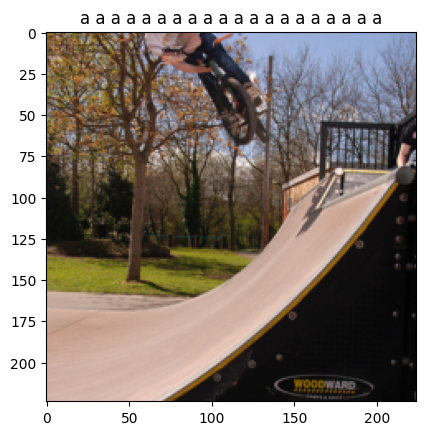

Epoch 33/40 [110/127] - Loss: 7.40489

Epoch 33/40 [120/127] - Loss: 7.40964

Starting epoch 34/40

Epoch 34/40 [1/127] - Loss: 7.40014

Epoch 34/40 [10/127] - Loss: 7.44233

Epoch 34/40 [20/127] - Loss: 7.40841

Epoch 34/40 [30/127] - Loss: 7.41769

Epoch 34/40 [40/127] - Loss: 7.40681

Epoch 34/40 [50/127] - Loss: 7.40896

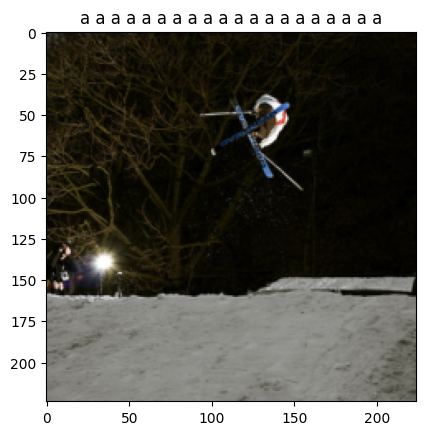

Epoch 34/40 [60/127] - Loss: 7.40952

Epoch 34/40 [70/127] - Loss: 7.42965

Epoch 34/40 [80/127] - Loss: 7.41035

Epoch 34/40 [90/127] - Loss: 7.41380

Epoch 34/40 [100/127] - Loss: 7.42607

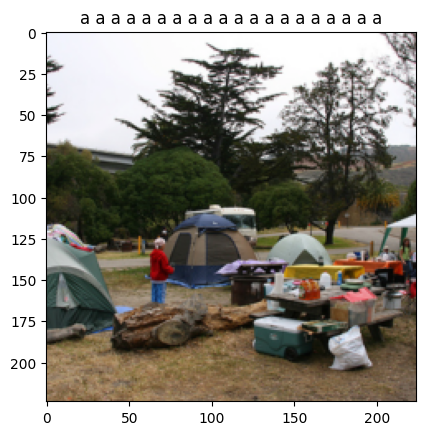

Epoch 34/40 [110/127] - Loss: 7.42176

Epoch 34/40 [120/127] - Loss: 7.40440

Starting epoch 35/40

Epoch 35/40 [1/127] - Loss: 7.41401

Epoch 35/40 [10/127] - Loss: 7.40910

Epoch 35/40 [20/127] - Loss: 7.42048

Epoch 35/40 [30/127] - Loss: 7.40622

Epoch 35/40 [40/127] - Loss: 7.42051

Epoch 35/40 [50/127] - Loss: 7.39996

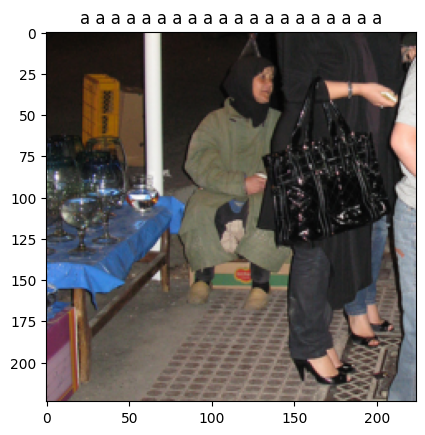

Epoch 35/40 [60/127] - Loss: 7.42308

Epoch 35/40 [70/127] - Loss: 7.41287

Epoch 35/40 [80/127] - Loss: 7.40853

Epoch 35/40 [90/127] - Loss: 7.41431

Epoch 35/40 [100/127] - Loss: 7.40650

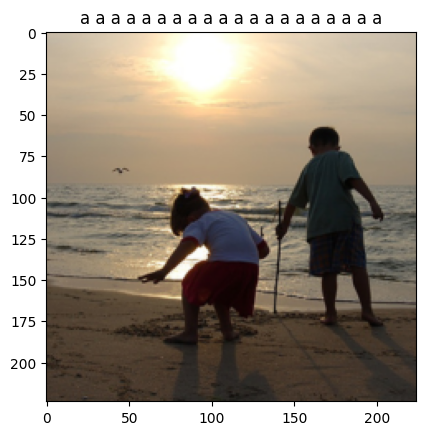

Epoch 35/40 [110/127] - Loss: 7.38263

Epoch 35/40 [120/127] - Loss: 7.41586

Starting epoch 36/40

Epoch 36/40 [1/127] - Loss: 7.39671

Epoch 36/40 [10/127] - Loss: 7.40715

Epoch 36/40 [20/127] - Loss: 7.40765

Epoch 36/40 [30/127] - Loss: 7.41062

Epoch 36/40 [40/127] - Loss: 7.41985

Epoch 36/40 [50/127] - Loss: 7.41874

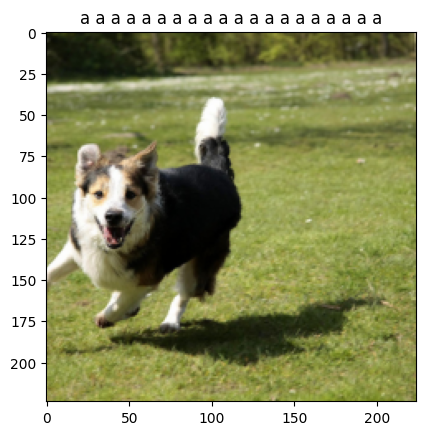

Epoch 36/40 [60/127] - Loss: 7.40576

Epoch 36/40 [70/127] - Loss: 7.40506

Epoch 36/40 [80/127] - Loss: 7.42254

Epoch 36/40 [90/127] - Loss: 7.42817

Epoch 36/40 [100/127] - Loss: 7.40481

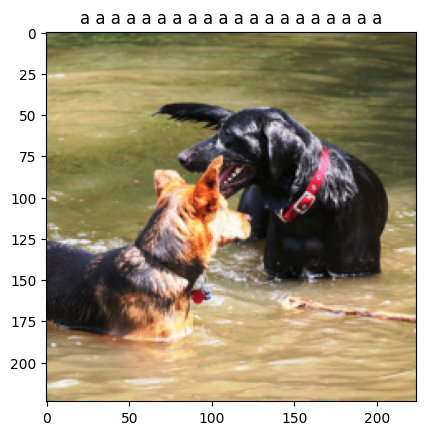

Epoch 36/40 [110/127] - Loss: 7.41194

Epoch 36/40 [120/127] - Loss: 7.39558

Starting epoch 37/40

Epoch 37/40 [1/127] - Loss: 7.40635

Epoch 37/40 [10/127] - Loss: 7.39998

Epoch 37/40 [20/127] - Loss: 7.39678

Epoch 37/40 [30/127] - Loss: 7.40095

Epoch 37/40 [40/127] - Loss: 7.40973

Epoch 37/40 [50/127] - Loss: 7.41584

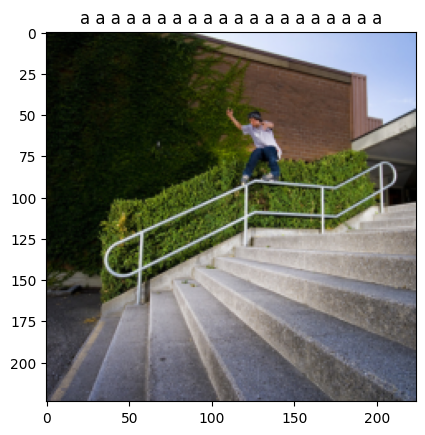

Epoch 37/40 [60/127] - Loss: 7.40436

Epoch 37/40 [70/127] - Loss: 7.41488

Epoch 37/40 [80/127] - Loss: 7.40745

Epoch 37/40 [90/127] - Loss: 7.39996

Epoch 37/40 [100/127] - Loss: 7.41646

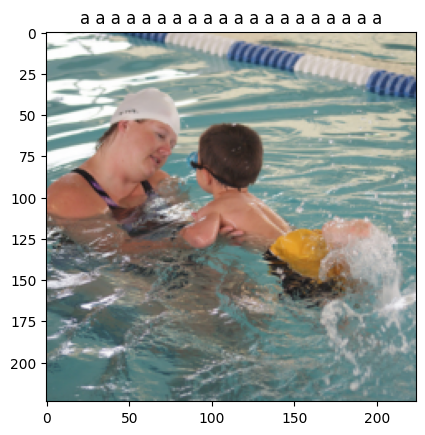

Epoch 37/40 [110/127] - Loss: 7.39931

Epoch 37/40 [120/127] - Loss: 7.40792

Starting epoch 38/40

Epoch 38/40 [1/127] - Loss: 7.41306

Epoch 38/40 [10/127] - Loss: 7.40336

Epoch 38/40 [20/127] - Loss: 7.41703

Epoch 38/40 [30/127] - Loss: 7.42057

Epoch 38/40 [40/127] - Loss: 7.41580

Epoch 38/40 [50/127] - Loss: 7.40449

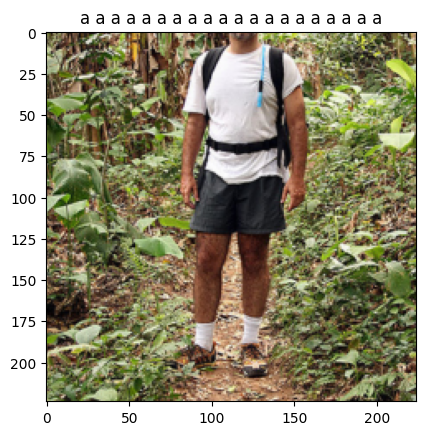

Epoch 38/40 [60/127] - Loss: 7.41957

Epoch 38/40 [70/127] - Loss: 7.41170

Epoch 38/40 [80/127] - Loss: 7.42471

Epoch 38/40 [90/127] - Loss: 7.39958

Epoch 38/40 [100/127] - Loss: 7.39533

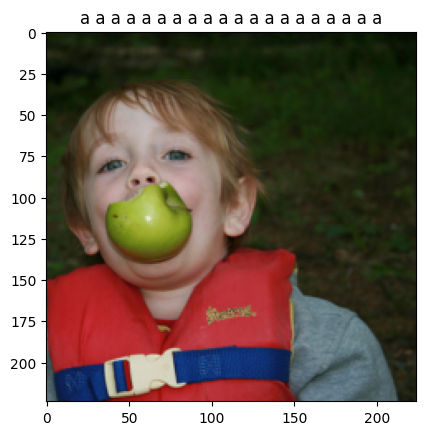

Epoch 38/40 [110/127] - Loss: 7.37069

Epoch 38/40 [120/127] - Loss: 7.41400

Starting epoch 39/40

Epoch 39/40 [1/127] - Loss: 7.43201

Epoch 39/40 [10/127] - Loss: 7.41265

Epoch 39/40 [20/127] - Loss: 7.40309

Epoch 39/40 [30/127] - Loss: 7.40850

Epoch 39/40 [40/127] - Loss: 7.41418

Epoch 39/40 [50/127] - Loss: 7.40742

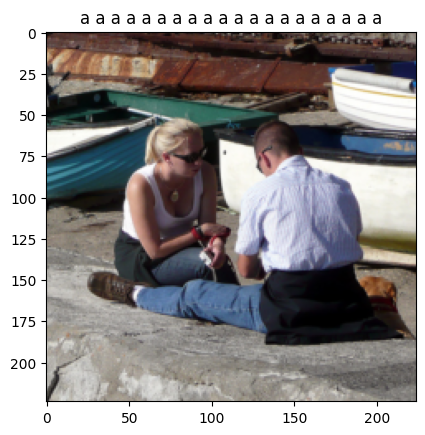

Epoch 39/40 [60/127] - Loss: 7.40390

Epoch 39/40 [70/127] - Loss: 7.39609

Epoch 39/40 [80/127] - Loss: 7.41348

Epoch 39/40 [90/127] - Loss: 7.41748

Epoch 39/40 [100/127] - Loss: 7.41224

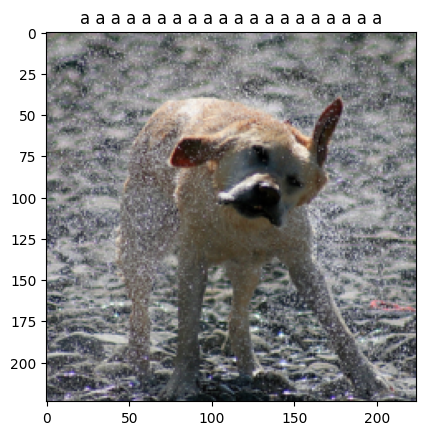

Epoch 39/40 [110/127] - Loss: 7.39212

Epoch 39/40 [120/127] - Loss: 7.42442

Starting epoch 40/40

Epoch 40/40 [1/127] - Loss: 7.39006

Epoch 40/40 [10/127] - Loss: 7.41078

Epoch 40/40 [20/127] - Loss: 7.39563

Epoch 40/40 [30/127] - Loss: 7.39640

Epoch 40/40 [40/127] - Loss: 7.40434

Epoch 40/40 [50/127] - Loss: 7.39459

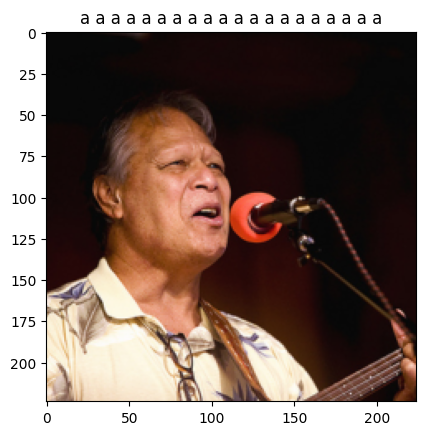

Epoch 40/40 [60/127] - Loss: 7.41376

Epoch 40/40 [70/127] - Loss: 7.38566

Epoch 40/40 [80/127] - Loss: 7.39700

Epoch 40/40 [90/127] - Loss: 7.41104

Epoch 40/40 [100/127] - Loss: 7.42262

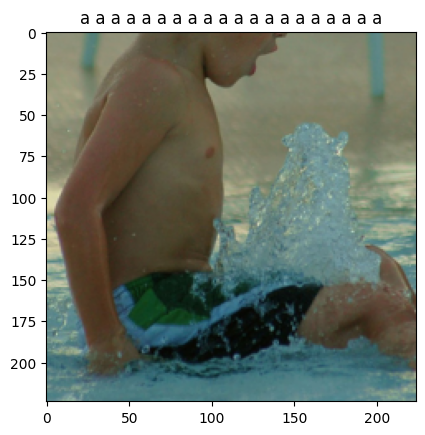

Epoch 40/40 [110/127] - Loss: 7.41470

Epoch 40/40 [120/127] - Loss: 7.40379

In [48]:
# Here we define the total steps, the number of epochs and the print every
total_steps = len(train_data_loader) 
# Here we define the number of epochs and when to print results 
num_epochs = 40
print_every = 10

# The for loop will go through each epoch and each batch and train the model
for epoch in range(1, num_epochs + 1):
    print(f"Starting epoch {epoch}/{num_epochs}")
    # For each batch in the training data loader, we will train the model. The batch contains the image and the captions
    for idx, (image, captions) in enumerate(iter(train_data_loader)):
        image, captions = image.to(device), captions.to(device)
        optimizer.zero_grad()
        # Feed forward
        outputs, attentions = model(image, captions)
        # Calculate the batch loss
        targets = captions[:, 1:] 
        # The loss is calculated using the cross entropy loss
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        # Display progress
        if (idx + 1) % print_every == 0 or idx == 0:  
            print(f"Epoch {epoch}/{num_epochs} [{idx + 1}/{total_steps}] - Loss: {loss.item():.5f}")
        # Here we generate the caption to see progress
        if (idx + 1) % (5 * print_every) == 0:  
            model.eval()
            with torch.no_grad():
                dataiter = iter(val_data_loader)
                img, _ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps, alphas = model.decoder.generate_caption(features, vocab=train_dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0], title=caption) 
            model.train()

    # Save the model at the end of each epoch
    save_model(model, epoch)


In [ ]:
for img, captions_vec in val_data_loader:
    # Process each image in the batch
    for i in range(img.size(0)):
        features = model.encoder(img[i:i+1].to(device))  # Move the image slice directly to the device
        caps, alphas = model.decoder.generate_caption(features, max_len=20, vocab=train_dataset.vocab)
        caps = caps[:-1]  # Remove the end token if present
        caption = ' '.join(caps)
        generated_captions.append(caption)

        # Prepare the reference captions
        ref_captions = []
        for idx in captions_vec[i]:
            word = train_dataset.vocab.itos[idx.item()]
            if word == "<EOS>":
                break
            ref_captions.append(word)

        reference_captions.append(' '.join(ref_captions))

for i in range(5):  # Show first 5 results as an example
    print("Generated:", generated_captions[i])
    print("Reference:", reference_captions[i])


Generated: a man and a woman are standing in front of a building .

Reference: <SOS> dog girl man dog event red fire climbing dog and in dog girl .

Generated: two dogs running on the beach .

Reference: <SOS> black an door leaps a boys holding .

Generated: a bride and groom in a wedding party .

Reference: <SOS> a girl each a <UNK> in a and little a person public .

Generated: a young girl in a blue shirt rides a swing .

Reference: <SOS> blue walks man a ball for little dog get .

Generated: a boy is jumping on a sidewalk in the street .

Reference: <SOS> a girl sit a sitting the mouth girl little brown baby grey no as the a doing down .